# this is runs model variations

# TODO
### > save_info function is overwriting itself which is pointless...
### ~~>change the scoreing method insted of weighted avg... its weight avg - anti avg...~~
### ~~> i want targs at the top so i can quickly go through differnt verisons of shit- but its pointless until i fix the true positive thing~~

In [1]:
from datetime import datetime
clean_initiate= datetime.now()


In [2]:
info = {}
from datetime import datetime
import math
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import cufflinks as cf
cf.go_offline(connected=False)
stamp = str(datetime.now())
info['stamp'] = stamp
import os
path = 'clean_data/'
info['path'] = path
sheets = os.listdir(path)
pd.DataFrame(sheets)

,0
0,"scaled_BATS PW, 60.csv"
1,"targets_BATS PW, 60.csv"
2,"features_BATS PW, 60.csv"


In [3]:
scaled_features = [s for s in sheets if 'scaled' in s][0]
target_sheet    = [s for s in sheets if 'targets'in s][0]
features        = [s for s in sheets if 'features'in s][0]
print('scaled:',scaled_features,'\ntargets:',target_sheet,'\nfeatures',features)

#features in fdf
sheet = path+features#sheets[2] 
fdf = pd.read_csv(sheet)
fdf = fdf.rename(columns={'time':'date'})

#TARGETS GO IN DF
df = pd.read_csv(path+target_sheet)  #sheets[0])
df = df.rename(columns={'time':'date'})
#makeing copys in case fuck-ups
ddf = df.copy()
dfdf = fdf.copy()
df.head()

scaled: scaled_BATS PW, 60.csv 
targets: targets_BATS PW, 60.csv 
features features_BATS PW, 60.csv


# REMOVING THE FUCKING INDEXES...

In [5]:
#bullshit = ['Unnamed: 0','index']
#fdf = fdf.drop(bullshit,axis=1)
#df = df.drop(bullshit,axis=1)
fdf.head()

,date,Open,High,Low,Close,Volume,two_crow,three_black_crows,threeinside updown,threelinestrike,...,TASUKIGAP,THRUSTING,TRISTAR,UNIQUE3RIVER,UPSIDEGAP2CROWS,XSIDEGAP3METHODS,next_day,last_close,delta,delta_up
0,2008-12-29 10:30:00,13.02,13.02,13.00,13.00,784,0,0,0,0,...,0,0,0,0,0,0,True,12.75,0.019608,True
1,2008-12-29 11:30:00,13.00,14.00,13.00,14.00,421,0,0,0,0,...,0,0,0,0,0,0,False,12.75,0.019608,True
2,2008-12-29 13:30:00,13.75,13.75,13.75,13.75,100,0,0,0,0,...,0,0,0,0,0,0,False,12.75,0.019608,True
3,2008-12-29 15:30:00,13.75,14.25,13.75,14.25,700,0,0,0,0,...,0,0,0,0,0,0,False,12.75,0.019608,True
4,2008-12-30 11:30:00,14.60,14.60,14.60,14.60,282,0,0,0,0,...,0,0,0,0,0,0,True,14.25,0.024561,True


In [6]:
df.head()

,date,Open,High,Low,Close,Volume,two_crow,three_black_crows,threeinside updown,threelinestrike,...,minus_5!,plus_5!,Highlast_10!,Lowlast_10!,uped_10!,downed_10!,uped_20!,downed_20!,uped_5!,downed_5!
0,2008-12-29 10:30:00,13.02,13.02,13.00,13.00,784,0,0,0,0,...,12.3500,13.6710,14.75,13.00,True,False,False,False,True,False
1,2008-12-29 11:30:00,13.00,14.00,13.00,14.00,421,0,0,0,0,...,12.3500,14.7000,14.75,13.00,False,False,False,False,True,False
2,2008-12-29 13:30:00,13.75,13.75,13.75,13.75,100,0,0,0,0,...,13.0625,14.4375,14.75,13.26,False,False,False,False,True,False
3,2008-12-29 15:30:00,13.75,14.25,13.75,14.25,700,0,0,0,0,...,13.0625,14.9625,14.75,13.26,False,False,False,False,False,False
4,2008-12-30 11:30:00,14.60,14.60,14.60,14.60,282,0,0,0,0,...,13.8700,15.3300,14.75,12.85,False,True,False,False,False,True


# targets

In [7]:
#CREATING LIST OF TARGETS!
targs = []
for i in df.columns:
    if '!' in i:
        targs.append(i)
tardf = pd.DataFrame(targs,columns=['targets'])
tardf

,targets
0,STDR10:up_target:_0.5!
1,STDR10:down_target:_0.5!
2,STDR10:up_target:_1!
3,STDR10:down_target:_1!
4,STDR10:up_target:_2!
5,STDR10:down_target:_2!
6,High_ahead!
7,Low_ahead!
8,STDR10:down_target:_2_HIT!
9,STDR10:down_target:_1_HIT!


In [8]:
target  = targs[22]
dtarget = targs[23]
info['target'] = df[target]
print('target...............:     ',target, '\nanti-target..........:',dtarget)
print('rows:',len(df))

target...............:      uped_10! 
anti-target..........: downed_10!
rows: 1467


# split here and load in sheets..

In [9]:
#SPLIT BASED ON PERCENT
split_per = 0.3 * len(df)
split     = len(df) - int(split_per)

#MANUAL SPLIT
#split = 1000
split

1027

In [10]:
print('lenth:',len(fdf),len(df))

print(split)

lenth: 1467 1467
1027


In [11]:
fe_first = fdf[:split]
df_first  = df[:split]

#second 
fe_second = fdf[split:]
df_second = df[split:]
#goingto have to do curent differently, by saving the columns this will be easy
#current= fdf[:-100]

#  functions

In [12]:
from tqdm import trange
def sheet_n_sec():
    #this saves the sheet and name to the refrence dictionary 'info'
    info['sheet'] = sheet
    info['sec'] = sheet.replace('.csv','')
    
def save_timeframe():
    #saves the timeframe to the refrence dictionary 'info' 
    tfr = str(pd.Timedelta(df.index[0])-pd.Timedelta(df.index[1]))
    tfr = tfr.split('.')[0]
    info['time_frame'] = tfr    

    
def save_start_stop():
    #this saves the start and stop dates to the dic 'info'
    start = str(df['Date'][0])
    end = str(df['Date'][-1:])
    info['start'] = start
    info['end'] = end    

def df_split(df,split_pct_fmEnd=.2):
    #splits a dataframe into 'first'&'second' based on a given percentage
    split = int(math.ceil(split_pct_fmEnd*len(df)))
    split = int(len(df) - forcast_out*split_pct_fmEnd)
    print('df_len',len(df))
    print('split is',split)
    first = df[:split]
    second = df[split:]
    print('first_ends:',first.index[-1])
    print('second_starts:',second.index[0])
    return first, second

def ttsplit(x,y):
    #train_test_split simply saves some trouble, of typeing
    x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.33,random_state=42)
    return x_train,x_test,y_train,y_test

'''MACHINE LEARNING MODELS'''
#model dictionary save attribtes and results of each model to be saved later
modeldic = {}
def lin_reg_fit(x,y,name=' ',notes=''):
    # i didnt add any dtargs to the metrics....i you think of any, DO IT DO IT DO IT!!!!!!!
    '''#ouputs the model, model_id, predictions & coef_df in a list, while saving all parmas to 'modeldic'
    runs a linear model and save the paramaters, outputs,
    the model,model_id, prediction, and a coeficiant dataframe '''
    indic = {}
    mstamp = str(datetime.now())
    mtype = 'LinearRegression'
    sn = mstamp.split('.')[1]
    modelid = mtype+sn
    #adding paramaters
    indic['model_id'] = modelid
    indic['model_name'] = ltarget+modelid #this is striclty beinf used for nameing
    indic['model_notes'] = 'fit_intercept=False' #notes
    indic['stamp'] = mstamp
    indic['model_type'] = mtype
    indic['features'] = str(x.columns)
    indic['target']   = ltarget
    #setting up model
    lm = LinearRegression(fit_intercept=False)
    lm.fit(x_train,y_train)
    pred = lm.predict(x_test)
    jplt = sns.jointplot(y_test,pred)
    coef = lm.coef_ 
    
    codf = pd.DataFrame(coef,x.columns,columns=['coefs'])
    #this would be if you wanted to rank them ....
    #for i in trange(0,len(codf)):
    #    if codf['coefs'][i] < 0:
    #        codf['coefs'][i] = codf['coefs'][i] * -1
    codf = codf.T
    
    codf.iplot(kind='bar',theme='solar')
    r2 = r2_score(y_test,pred)
    mae = mean_absolute_error(y_test,pred)
    indic['r2_score'] = r2
    indic['MAE'] = mae
    print('r2 score',r2)
    print('mean_absolute_er',mae)
    codf
    indic['coefs'] = codf.T['coefs'].values
    modeldic[modelid] = indic
    return [lm, modelid, pred,codf]#,codf.T.iplot(kind='bar',theme='solar')
def log_reg_fit(x,y,dy,name=' ',notes=''):
    #ouputs the model, model_id, predictions & coef_df in a list, while saving all parmas to 'modeldic'
    #runs a Logistic model and save the paramaters, outputs,
    #the model,model_id, prediction, and a coeficiant dataframe 
    
    indic = {}
    mstamp = str(datetime.now())
    '''model'''
    mtype = 'LogisticRegression'
    sn = mstamp.split('.')[1]
    modelid = mtype+sn
    #adding paramaters
    indic['model_id'] = modelid
    indic['model_name'] = target+modelid #this is striclty beinf used for nameing
    indic['model_notes'] = 'max_iter is on 4000'#notes
    indic['stamp'] = mstamp
    indic['model_type'] = mtype
    indic['features'] = str(x.columns)
    #setting up model
    '''object name'''
    lr = LogisticRegression(max_iter=4000)
    lr.fit(x_train,y_train)
    pred = lr.predict(x_test)
    #dont think this will work on 
    coef = lr.coef_ 
    
    codf = pd.DataFrame(coef,columns=[x.columns])#,x.columns)#,columns=['coefs'])
    #this would be if you wanted to rank them ....
    #for i in trange(0,len(codf)):
    #    if codf['coefs'][i] < 0:
    #        codf['coefs'][i] = codf['coefs'][i] * -1
    #codf = codf.T
    
    codf.iplot(kind='bar',theme='solar')
    
    #metrics
    clr = classification_report(y_test,pred)
    dclr= classification_report(dy_test,pred)
    print('~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~\n',clr)
    print('..............................vs................................')
    print('~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~\n',dclr)
    comx = confusion_matrix(y_test,pred)
    print("~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~" )
    print("                 ......///",comx[0], "\\\........." )
    print("                 ...../// ",comx[1], " \\\........." )
    #classification report
    clr = classification_report(y_test,pred,output_dict=True)
    clrdf = pd.DataFrame(clr)
    indic['true_positive']=clr['True']['precision']
    indic['true_negitive']=clr['False']['precision']
    indic['weighted avg'] =clr['weighted avg']['precision']
    indic['f1_score']     =clr['weighted avg']['f1-score']
    codf
    modeldic[modelid] = indic
    return [lr, modelid, pred,clrdf,codf] #,codf.T.iplot(kind='bar',theme='solar')

def tree_fit(x,y,dy,name=' ',notes=''):
    indic = {}
    mstamp = str(datetime.now())
    '''model'''
    mtype = 'Tree'
    sn = mstamp.split('.')[1]
    modelid = mtype+sn
    #adding paramaters
    indic['model_id'] = modelid
    indic['model_name'] = target+modelid #this is striclty beinf used for nameing
    indic['model_notes'] = 'default-tree '#notes
    indic['stamp'] = mstamp
    indic['model_type'] = mtype
    indic['features'] = str(x.columns)
    indic['target']   = target
    #setting up model
    '''object name'''
    tree = DecisionTreeClassifier('entropy')
    tree.fit(x_train,y_train)
    pred = tree.predict(x_test)
    #metrics
    clr = classification_report(y_test,pred)
    dclr= classification_report(dy_test,pred)
    print('~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~\n',clr)
    print('..............................vs................................')
    print('~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~\n',dclr)
    comx = confusion_matrix(y_test,pred)
    print("~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~" )
    print("                 ......///",comx[0], "\\\........." )
    print("                 ...../// ",comx[1], " \\\........." )
    #classification report
    clr = classification_report(y_test,pred,output_dict=True)
    clrdf = pd.DataFrame(clr)
    #indic['true_positive']=clr['True']['precision']
    #indic['true_negitive']=clr['False']['precision']
    #indic['weighted avg'] =clr['weighted avg']['precision']
    #indic['f1_score']     =clr['weighted avg']['f1-score']
    modeldic[modelid] = indic
    return [tree, modelid, pred,clrdf] #,codf.T.iplot(kind='bar',theme='solar')

def forest_fit(x,y,dy,name=' ',notes=''):
    indic = {}
    mstamp = str(datetime.now())
    '''model'''
    mtype = 'forest'
    sn = mstamp.split('.')[1]
    modelid = mtype+sn
    #adding paramaters
    indic['model_id'] = modelid
    indic['model_name'] = target+modelid #this is striclty beinf used for nameing
    indic['model_notes'] =  'running 200 estimators'#notes
    indic['stamp'] = mstamp
    indic['model_type'] = mtype
    indic['features'] = str(x.columns)
    indic['target']   = target
    #setting up model
    '''object name'''
    forest = RandomForestClassifier(200,'entropy')
    forest.fit(x_train,y_train)
    pred = forest.predict(x_test)
    #metrics
    clr = classification_report(y_test,pred)
    dclr= classification_report(dy_test,pred)
    print('~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~\n',clr)
    print('..............................vs................................')
    print('~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~\n',dclr)
    comx = confusion_matrix(y_test,pred)
    print("~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~" )
    print("                 ......///",comx[0], "\\\........." )
    print("                 ...../// ",comx[1], " \\\........." )
    #classification report
    clr = classification_report(y_test,pred,output_dict=True)
    clrdf = pd.DataFrame(clr)
    indic['true_positive']=clr['True']['precision']
    indic['true_negitive']=clr['False']['precision']
    indic['weighted avg'] =clr['weighted avg']['precision']
    indic['f1_score']     =clr['weighted avg']['f1-score']
    modeldic[modelid] = indic
    return [forest, modelid, pred,clrdf] #,codf.T.iplot(kind='bar',theme='solar')


def lin_validate(lm,x):
    pred = lm[0].predict(x)
    predf[lm[1]] = pred
    redf = predf[['Close',lm[1]]]
    redf['time'] = ddf['Date']
    redf.set_index('time',inplace=True)
    r2 = r2_score(y,pred)
    mae = mean_absolute_error(y,pred)
    modeldic[lm[1]]['r2_score'] = r2
    modeldic[lm[1]]['MAE'] = mae
    #modeldic[lm[1]]['target'] = ltarget
    print('r2 score',r2)
    print('mean_absolute_er',mae)
    #codf
    #modeldic[lm[1]]['coefs'] = codf.T['coefs'].values
    #modeldic[lm[1]] = indic
    sola(redf)
    sns.jointplot(pred,df_second[ltarget])

def binary_validate(mdl,x):
    pred = mdl[0].predict(x)
    predf[mdl[1]] = pred
    redf = predf[[target,'Close',mdl[1]]]
    redf['time'] = ddf['Date']
    redf.set_index('time',inplace=True)
    sdf = scale(redf)
    sdf['time'] = ddf['Date']
    sdf.set_index('time',inplace=True)
    #metrics
    clr = classification_report(y,pred)
    dclr= classification_report(dy_test,pred)
    print('~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~\n',clr)
    print('..............................vs................................')
    print('~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~\n',dclr)
    comx = confusion_matrix(y,pred)
    print("~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~" )
    print("                 ......///",comx[0], "\\\........." )
    print("                 ...../// ",comx[1], " \\\........." )
    #the real price plot
    scale2close= mdl[1]+'$scale'
    redf[scale2close] = redf[mdl[1]].replace(True,1)
    redf[scale2close] = redf[scale2close].replace(1,redf['Close'])
    sola(redf[['Close',scale2close]])
    #scaled close
    sola(sdf.drop(target,1))
    #scaled bionary
    sola(sdf[[target,mdl[1]]])
    clr = classification_report(y,pred,output_dict=True)
    clrdf = pd.DataFrame(clr)
    modeldic[mdl[1]]['true_positive']=clr['True']['precision']
    modeldic[mdl[1]]['true_negitive']=clr['False']['precision']
    modeldic[mdl[1]]['weighted avg'] =clr['weighted avg']['precision']
    modeldic[mdl[1]]['f1_score']     =clr['weighted avg']['f1-score']
    modeldic[mdl[1]]['f1_score']
    #modeldic[mdl[1]] = dic
    return redf,pred



 
    
def scale(df):
    '''returns your data frame scaled!'''
    scale = StandardScaler()
    scaled = scale.fit_transform(df)
    sdf = pd.DataFrame(scaled,columns=df.columns)
    return sdf



def sola(df):
    return df.iplot(theme='solar',fill=True)

def mix_info(modeldic,info):
    #takes the model dict and ouputs dataFrame
    # with the global data from 'info' dict
    modf = pd.DataFrame(modeldic)
    modf = modf.T
    for i in info.keys():
        modf[i] = info[i]
    modf = modf.T    
    modf.index.name = 'index'
    return modf

def save_info(csvname='model_preformance'):
    cname = (csvname+'.csv')
    info_path = 'PREDICTION_DATA/'
    if not os.path.exists(info_path):
        os.mkdir(info_path.replace('/',''))
    yn = 'y'#input('do you want to save these results y/n?')
    if yn == 'y':
        yyn = 'loopy'#input('is there anything you want to add?')
        if yyn == 'n':
            pass
        else:
            #add_stuff = input('type some')
            add_some = yyn
            info['after_thoughts'] = add_some
            info['sheet']          = sheet
        #forming the dataframe
        modf = mix_info(modeldic,info)
        if cname in os.listdir(info_path):
            print('its here ill update it')
            mpdf = pd.read_csv(info_path+cname,index_col='index')
            for i in modf.columns:
                mpdf[i] = modf[i]
                mpdf.to_csv(info_path+cname)
            #modf.to_csv(info_path+cname)
            print('cool i saved it!')
        else:
            print('its not there...')
            modf.to_csv(info_path+cname)#,index_label='index')
            print('..................now it is motha fucka!')
            


'''splits the date to a train/testset,validateset'''
def df_splitt(split):
    first = df[:split]
    second = df[split:]
    return first , second

'''get rid of anything that leaks data of the future, marked by an exlamtion mark '''
def lose_giveaways(df):
    gaways = []
    for i in df.columns:
        if '!' in i:
            gaways.append(i)
    return df.drop(gaways,axis = 1)

pd.set_option('display.max_columns',500)
pd.set_option('display.max_rows',10000)

#highlight de boo-LEANS!
def hl(df):
    def highlight(boo):
        criteria = boo == True
        return['background-color: green'if i else '' for i in criteria]
    df = df.style.apply(highlight)
    return df

# [[[[{{{{{{{{{{{ MACHINE LEARNING ZONE! }}}}}}}}}}]]]

##### .................. ////////////////////////////////////////SPLIT\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\\...............

## <<<<<<<<<<<<<<<<<<< `LINEAR MODEL` >>>>>>>>>>>>>>>>>>>>>

In [13]:
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error,mean_absolute_error

In [14]:
df.columns

Index(['date', 'Open', 'High', 'Low', 'Close', 'Volume', 'two_crow',
       'three_black_crows', 'threeinside updown', 'threelinestrike',
       '3outside', '3starsinsouth', '3WHITESOLDIERS', 'ABANDONEDBABY',
       'ADVANCEBLOCK', 'BELTHOLD', 'BREAKAWAY', 'CLOSINGMARUBOZU',
       'CONCEALBABYSWALL', 'COUNTERATTACK', 'DARKCLOUDCOVER', 'DOJI',
       'DOJISTAR', 'DRAGONFLYDOJI', 'ENGULFING', 'EVENINGDOJISTAR',
       'EVENINGSTAR', 'GAPSIDESIDEWHITE', 'GRAVESTONEDOJI', 'HAMMER',
       'HANGINGMAN', 'HARAMI', 'HARAMICROSS', 'HIGHWAVE', 'HIKKAKE',
       'HIKKAKEMOD', 'HOMINGPIGEON', 'IDENTICAL3CROWS', 'INNECK',
       'INVERTEDHAMMER', 'KICKING', 'KICKINGBYLENGTH', 'LADDERBOTTOM',
       'LONGLEGGEDDOJI', 'LONGLINE', 'MARUBOZU', 'MATCHINGLOW', 'MATHOLD',
       'MORNINGDOJISTAR', 'MORNINGSTAR', 'ONNECK', 'PIERCING', 'RICKSHAWMAN',
       'RISEFALL3METHODS', 'SEPARATINGLINES', 'SHOOTINGSTAR', 'SHORTLINE',
       'SPINNINGTOP', 'STALLEDPATTERN', 'STICKSANDWICH', 'TAKURI', 'TASUKIGAP',
  

In [15]:
#CREATING LIST OF TARGETS!
targs = []
for i in df.columns:
    if '!' in i:
        targs.append(i)
tardf = pd.DataFrame(targs,columns=['targets'])
tardf

,targets
0,STDR10:up_target:_0.5!
1,STDR10:down_target:_0.5!
2,STDR10:up_target:_1!
3,STDR10:down_target:_1!
4,STDR10:up_target:_2!
5,STDR10:down_target:_2!
6,High_ahead!
7,Low_ahead!
8,STDR10:down_target:_2_HIT!
9,STDR10:down_target:_1_HIT!


# ---------------{define your TARGET!}--------------------

In [16]:
ltarget = targs[6]
ltarget

'High_ahead!'

In [17]:
fe_first = fe_first.rename(columns={'time':'date'})


In [18]:
fe_first

,date,Open,High,Low,Close,Volume,two_crow,three_black_crows,threeinside updown,threelinestrike,3outside,3starsinsouth,3WHITESOLDIERS,ABANDONEDBABY,ADVANCEBLOCK,BELTHOLD,BREAKAWAY,CLOSINGMARUBOZU,CONCEALBABYSWALL,COUNTERATTACK,DARKCLOUDCOVER,DOJI,DOJISTAR,DRAGONFLYDOJI,ENGULFING,EVENINGDOJISTAR,EVENINGSTAR,GAPSIDESIDEWHITE,GRAVESTONEDOJI,HAMMER,HANGINGMAN,HARAMI,HARAMICROSS,HIGHWAVE,HIKKAKE,HIKKAKEMOD,HOMINGPIGEON,IDENTICAL3CROWS,INNECK,INVERTEDHAMMER,KICKING,KICKINGBYLENGTH,LADDERBOTTOM,LONGLEGGEDDOJI,LONGLINE,MARUBOZU,MATCHINGLOW,MATHOLD,MORNINGDOJISTAR,MORNINGSTAR,ONNECK,PIERCING,RICKSHAWMAN,RISEFALL3METHODS,SEPARATINGLINES,SHOOTINGSTAR,SHORTLINE,SPINNINGTOP,STALLEDPATTERN,STICKSANDWICH,TAKURI,TASUKIGAP,THRUSTING,TRISTAR,UNIQUE3RIVER,UPSIDEGAP2CROWS,XSIDEGAP3METHODS,next_day,last_close,delta,delta_up
0,2008-12-29 10:30:00,13.020,13.020,13.000,13.000,784,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,True,12.750,0.019608,True
1,2008-12-29 11:30:00,13.000,14.000,13.000,14.000,421,0,0,0,0,0,0,0,0,0,100,0,100,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,100,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,False,12.750,0.019608,True
2,2008-12-29 13:30:00,13.750,13.750,13.750,13.750,100,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,100,0,0,0,0,0,0,0,0,0,-100,-100,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,False,12.750,0.019608,True
3,2008-12-29 15:30:00,13.750,14.250,13.750,14.250,700,0,0,0,0,0,0,0,0,0,100,0,100,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,100,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,False,12.750,0.019608,True
4,2008-12-30 11:30:00,14.600,14.600,14.600,14.600,282,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,100,-100,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,True,14.250,0.024561,True
5,2008-12-30 12:30:00,14.600,14.750,14.600,14.750,700,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,False,14.250,0.024561,True
6,2008-12-30 14:30:00,14.000,14.000,14.000,14.000,300,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,100,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,False,14.250,0.024561,True
7,2008-12-30 15:30:00,14.000,14.000,14.000,14.000,758,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,100,0,0,0,0,0,-100,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,False,14.250,0.024561,True
8,2008-12-30 16:30:00,14.190,14.190,14.190,14.190,1000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,100,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,False,14.250,0.024561,True
9,2009-01-02 12:30:00,13.560,13.560,13.560,13.560,1000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,100,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,-100,0,0,0,True,14.190,-0.044397,False


r2 score 0.8766043983629879
mean_absolute_er 0.5679478356125642


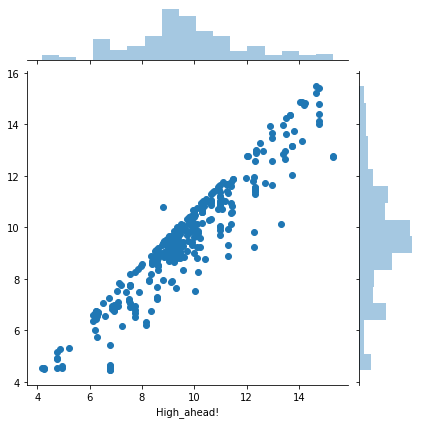

In [19]:
#SEPERATE FEATURES FROM TARGET

x = fe_first.drop('date',axis=1)
lx = x
y = df_first[ltarget]
#saving features to the thing
#info['target'] = df[target]

x_train,x_test,y_train,y_test = ttsplit(lx,y) #train_test_split simply saves some trouble, of typeing

#ouputs the model, model_id, predictions and coeficiant dataframe in a list, while saving all parmas to 'modeldic'
lm = lin_reg_fit(lx,y,notes='this is test 4')

In [20]:
lm[3].T

,coefs
Open,4.051115e-01
High,4.230998e-01
Low,-3.843391e-01
Close,4.818334e-01
Volume,-1.641591e-05
two_crow,1.821182e-13
three_black_crows,3.533632e-13
threeinside updown,-3.909314e-03
threelinestrike,-1.581998e-13
3outside,8.658808e-03


In [21]:
coedf = lm[3].T

In [22]:
coedf.sort_values('coefs',ascending=False)

,coefs
delta,1.126006e+00
Close,4.818334e-01
High,4.230998e-01
Open,4.051115e-01
last_close,1.189244e-01
next_day,4.778964e-02
delta_up,4.347588e-02
3outside,8.658808e-03
HARAMICROSS,4.521692e-03
THRUSTING,3.321624e-03


# lets build a log reg model function ...

In [23]:
import tqdm
help(tqdm)

Help on package tqdm:

NAME
    tqdm

PACKAGE CONTENTS
    __main__
    _main
    _monitor
    _tqdm
    _tqdm_gui
    _tqdm_notebook
    _tqdm_pandas
    _utils
    _version
    auto (package)
    autonotebook (package)

CLASSES
    builtins.KeyError(builtins.LookupError)
        tqdm._tqdm.TqdmKeyError
    builtins.RuntimeWarning(builtins.Warning)
        tqdm._monitor.TqdmSynchronisationWarning
    builtins.TypeError(builtins.Exception)
        tqdm._tqdm.TqdmTypeError
    builtins.Warning(builtins.Exception)
        tqdm._tqdm.TqdmWarning
            tqdm._tqdm.TqdmDeprecationWarning(tqdm._tqdm.TqdmWarning, builtins.DeprecationWarning)
            tqdm._tqdm.TqdmExperimentalWarning(tqdm._tqdm.TqdmWarning, builtins.FutureWarning)
            tqdm._tqdm.TqdmMonitorWarning(tqdm._tqdm.TqdmWarning, builtins.RuntimeWarning)
    threading.Thread(builtins.object)
        tqdm._monitor.TMonitor
    tqdm._utils.Comparable(builtins.object)
        tqdm._tqdm.tqdm
            tqdm._tqdm_gui.tq

In [24]:
tardf

,targets
0,STDR10:up_target:_0.5!
1,STDR10:down_target:_0.5!
2,STDR10:up_target:_1!
3,STDR10:down_target:_1!
4,STDR10:up_target:_2!
5,STDR10:down_target:_2!
6,High_ahead!
7,Low_ahead!
8,STDR10:down_target:_2_HIT!
9,STDR10:down_target:_1_HIT!


In [25]:
tarli = [8,9,10,11,12,13,22,23,24,25,26,27]
#tarli = [26,27,22,23,24,25,34,35,11,10,9,12,8,13]
for ml_target in tarli:
    print(df[targs[ml_target]].name)
    

STDR10:down_target:_2_HIT!
STDR10:down_target:_1_HIT!
STDR10:down_target:_0.5_HIT!
STDR10:up_target:_0.5_HIT!
STDR10:up_target:_1_HIT!
STDR10:up_target:_2_HIT!
uped_10!
downed_10!
uped_20!
downed_20!
uped_5!
downed_5!


target STDR10:down_target:_2_HIT! --> STDR10:up_target:_2_HIT!
target:      STDR10:down_target:_2_HIT! 
anti-target: STDR10:up_target:_2_HIT!


100%|██████████| 70/70 [00:00<00:00, 10096.68it/s]
/home/brado/.local/lib/python3.8/site-packages/sklearn/utils/validation.py:68: FutureWarning:

Pass criterion=entropy as keyword args. From version 0.25 passing these as positional arguments will result in an error



~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.76      0.77      0.77       226
        True       0.53      0.50      0.52       113

    accuracy                           0.68       339
   macro avg       0.64      0.64      0.64       339
weighted avg       0.68      0.68      0.68       339

..............................vs................................
~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.68      0.70      0.69       224
        True       0.38      0.36      0.37       115

    accuracy                           0.58       339
   macro avg       0.53      0.53      0.53       339
weighted avg       0.58      0.58      0.58       339

~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~
                 ....../// [175  51] \\.........
                 .....///  [56 57]

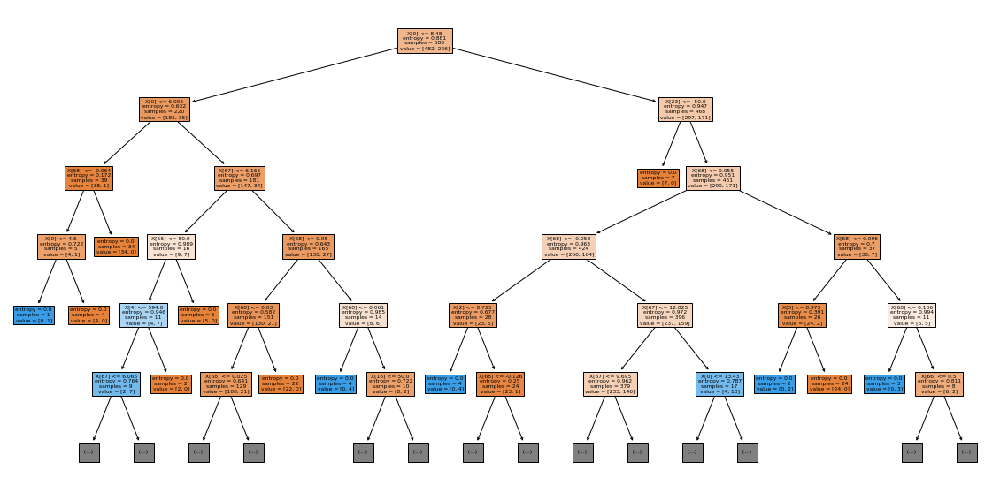

/home/brado/.local/lib/python3.8/site-packages/sklearn/utils/validation.py:68: FutureWarning:

Pass criterion=entropy as keyword args. From version 0.25 passing these as positional arguments will result in an error



~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.73      0.89      0.81       226
        True       0.62      0.35      0.45       113

    accuracy                           0.71       339
   macro avg       0.68      0.62      0.63       339
weighted avg       0.70      0.71      0.69       339

..............................vs................................
~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.65      0.80      0.72       224
        True       0.31      0.17      0.22       115

    accuracy                           0.59       339
   macro avg       0.48      0.49      0.47       339
weighted avg       0.54      0.59      0.55       339

~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~
                 ....../// [202  24] \\.........
                 .....///  [73 40]

r2 score 0.9017931862681606
mean_absolute_er 1.246245592858475


440 440
440
440
STDR10:down_target:_2_HIT!


STDR10:down_target:_2_HIT!


STDR10:down_target:_2_HIT!


its not there...
..................now it is motha fucka!
target STDR10:down_target:_1_HIT! --> STDR10:up_target:_1_HIT!
target:      STDR10:down_target:_1_HIT! 
anti-target: STDR10:up_target:_1_HIT!


100%|██████████| 70/70 [00:00<00:00, 8919.71it/s]
/home/brado/.local/lib/python3.8/site-packages/sklearn/utils/validation.py:68: FutureWarning:

Pass criterion=entropy as keyword args. From version 0.25 passing these as positional arguments will result in an error



~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.63      0.53      0.57       165
        True       0.61      0.71      0.66       174

    accuracy                           0.62       339
   macro avg       0.62      0.62      0.62       339
weighted avg       0.62      0.62      0.62       339

..............................vs................................
~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.38      0.34      0.36       157
        True       0.48      0.53      0.51       182

    accuracy                           0.44       339
   macro avg       0.43      0.44      0.43       339
weighted avg       0.44      0.44      0.44       339

~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~
                 ....../// [87 78] \\.........
                 .....///  [ 51 123]

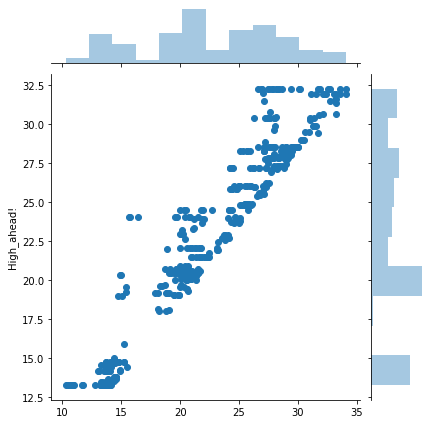

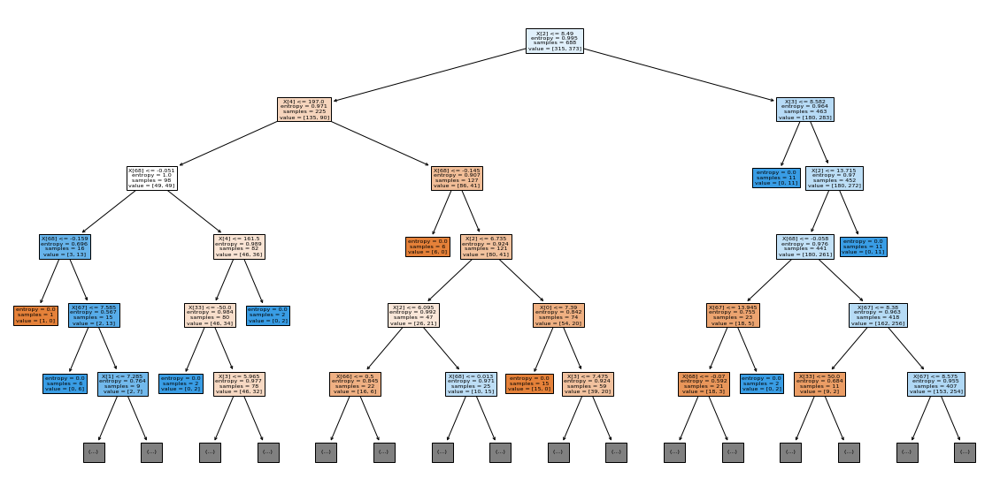

/home/brado/.local/lib/python3.8/site-packages/sklearn/utils/validation.py:68: FutureWarning:

Pass criterion=entropy as keyword args. From version 0.25 passing these as positional arguments will result in an error



~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.58      0.54      0.56       165
        True       0.59      0.63      0.61       174

    accuracy                           0.59       339
   macro avg       0.59      0.59      0.59       339
weighted avg       0.59      0.59      0.59       339

..............................vs................................
~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.38      0.37      0.37       157
        True       0.47      0.48      0.47       182

    accuracy                           0.43       339
   macro avg       0.42      0.42      0.42       339
weighted avg       0.43      0.43      0.43       339

~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~
                 ....../// [89 76] \\.........
                 .....///  [ 64 110]

r2 score 0.9017931862681606
mean_absolute_er 1.246245592858475


440 440
440
440
STDR10:down_target:_1_HIT!


STDR10:down_target:_1_HIT!


STDR10:down_target:_1_HIT!


its here ill update it
cool i saved it!
target STDR10:down_target:_0.5_HIT! --> STDR10:up_target:_0.5_HIT!
target:      STDR10:down_target:_0.5_HIT! 
anti-target: STDR10:up_target:_0.5_HIT!


100%|██████████| 70/70 [00:00<00:00, 16340.23it/s]
/home/brado/.local/lib/python3.8/site-packages/sklearn/utils/validation.py:68: FutureWarning:

Pass criterion=entropy as keyword args. From version 0.25 passing these as positional arguments will result in an error



~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.43      0.41      0.42       115
        True       0.70      0.72      0.71       224

    accuracy                           0.61       339
   macro avg       0.57      0.56      0.56       339
weighted avg       0.61      0.61      0.61       339

..............................vs................................
~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.33      0.31      0.32       117
        True       0.65      0.67      0.66       222

    accuracy                           0.54       339
   macro avg       0.49      0.49      0.49       339
weighted avg       0.54      0.54      0.54       339

~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~
                 ....../// [47 68] \\.........
                 .....///  [ 63 161]

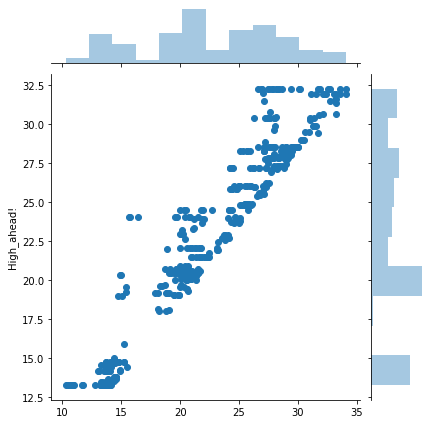

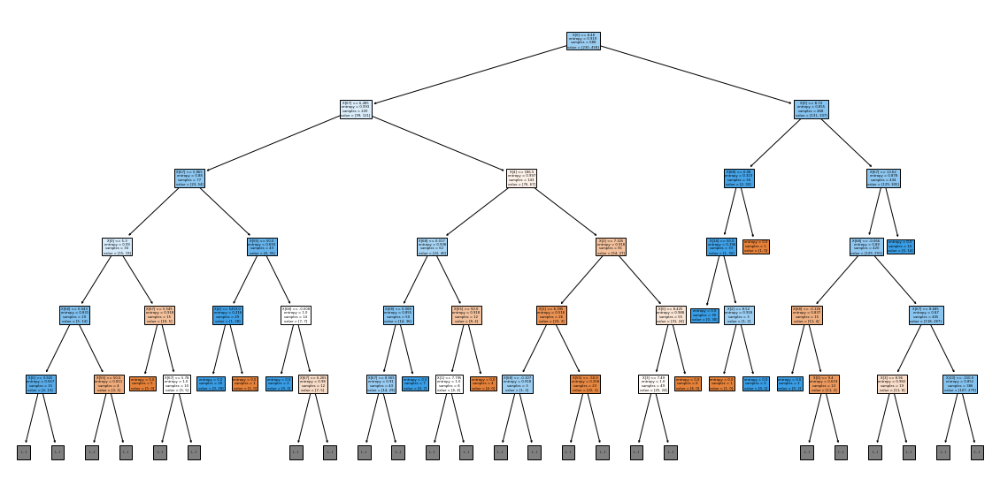

/home/brado/.local/lib/python3.8/site-packages/sklearn/utils/validation.py:68: FutureWarning:

Pass criterion=entropy as keyword args. From version 0.25 passing these as positional arguments will result in an error



~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.48      0.31      0.38       115
        True       0.70      0.83      0.76       224

    accuracy                           0.65       339
   macro avg       0.59      0.57      0.57       339
weighted avg       0.63      0.65      0.63       339

..............................vs................................
~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.28      0.18      0.22       117
        True       0.64      0.76      0.69       222

    accuracy                           0.56       339
   macro avg       0.46      0.47      0.46       339
weighted avg       0.51      0.56      0.53       339

~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~
                 ....../// [36 79] \\.........
                 .....///  [ 39 185]

r2 score 0.9017931862681606
mean_absolute_er 1.246245592858475


440 440
440
440
STDR10:down_target:_0.5_HIT!


STDR10:down_target:_0.5_HIT!


STDR10:down_target:_0.5_HIT!


its here ill update it
cool i saved it!
target STDR10:up_target:_0.5_HIT! --> STDR10:down_target:_0.5_HIT!
target:      STDR10:up_target:_0.5_HIT! 
anti-target: STDR10:down_target:_0.5_HIT!


100%|██████████| 70/70 [00:00<00:00, 7369.14it/s]
/home/brado/.local/lib/python3.8/site-packages/sklearn/utils/validation.py:68: FutureWarning:

Pass criterion=entropy as keyword args. From version 0.25 passing these as positional arguments will result in an error



~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.50      0.55      0.52       117
        True       0.75      0.72      0.73       222

    accuracy                           0.66       339
   macro avg       0.63      0.63      0.63       339
weighted avg       0.67      0.66      0.66       339

..............................vs................................
~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.27      0.30      0.28       115
        True       0.62      0.58      0.60       224

    accuracy                           0.49       339
   macro avg       0.44      0.44      0.44       339
weighted avg       0.50      0.49      0.49       339

~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~
                 ....../// [64 53] \\.........
                 .....///  [ 63 159]

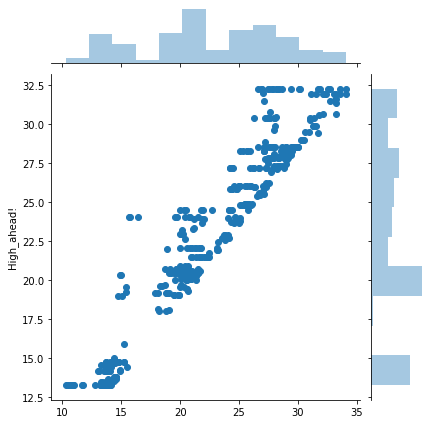

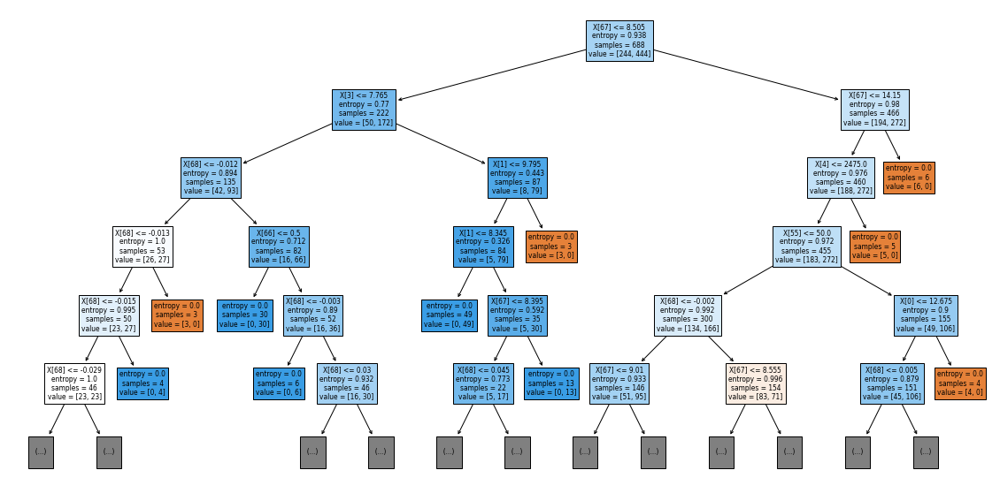

/home/brado/.local/lib/python3.8/site-packages/sklearn/utils/validation.py:68: FutureWarning:

Pass criterion=entropy as keyword args. From version 0.25 passing these as positional arguments will result in an error



~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.56      0.42      0.48       117
        True       0.73      0.83      0.78       222

    accuracy                           0.69       339
   macro avg       0.65      0.62      0.63       339
weighted avg       0.67      0.69      0.67       339

..............................vs................................
~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.24      0.18      0.21       115
        True       0.63      0.71      0.66       224

    accuracy                           0.53       339
   macro avg       0.43      0.44      0.44       339
weighted avg       0.50      0.53      0.51       339

~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~
                 ....../// [49 68] \\.........
                 .....///  [ 38 184]

r2 score 0.9017931862681606
mean_absolute_er 1.246245592858475


440 440
440
440
STDR10:up_target:_0.5_HIT!


STDR10:up_target:_0.5_HIT!


STDR10:up_target:_0.5_HIT!


its here ill update it
cool i saved it!
target STDR10:up_target:_1_HIT! --> STDR10:down_target:_1_HIT!
target:      STDR10:up_target:_1_HIT! 
anti-target: STDR10:down_target:_1_HIT!


100%|██████████| 70/70 [00:00<00:00, 6263.49it/s]
/home/brado/.local/lib/python3.8/site-packages/sklearn/utils/validation.py:68: FutureWarning:

Pass criterion=entropy as keyword args. From version 0.25 passing these as positional arguments will result in an error



~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.62      0.73      0.67       157
        True       0.73      0.62      0.67       182

    accuracy                           0.67       339
   macro avg       0.68      0.68      0.67       339
weighted avg       0.68      0.67      0.67       339

..............................vs................................
~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.43      0.48      0.45       165
        True       0.45      0.40      0.42       174

    accuracy                           0.44       339
   macro avg       0.44      0.44      0.44       339
weighted avg       0.44      0.44      0.44       339

~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~
                 ....../// [115  42] \\.........
                 .....///  [ 69 11

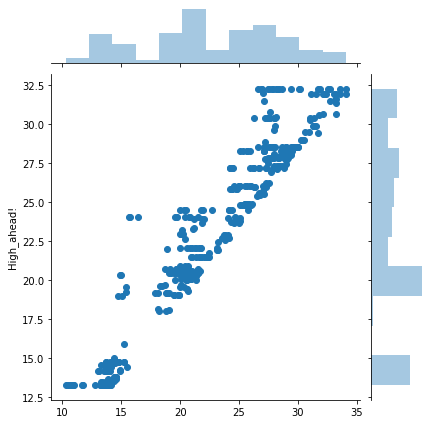

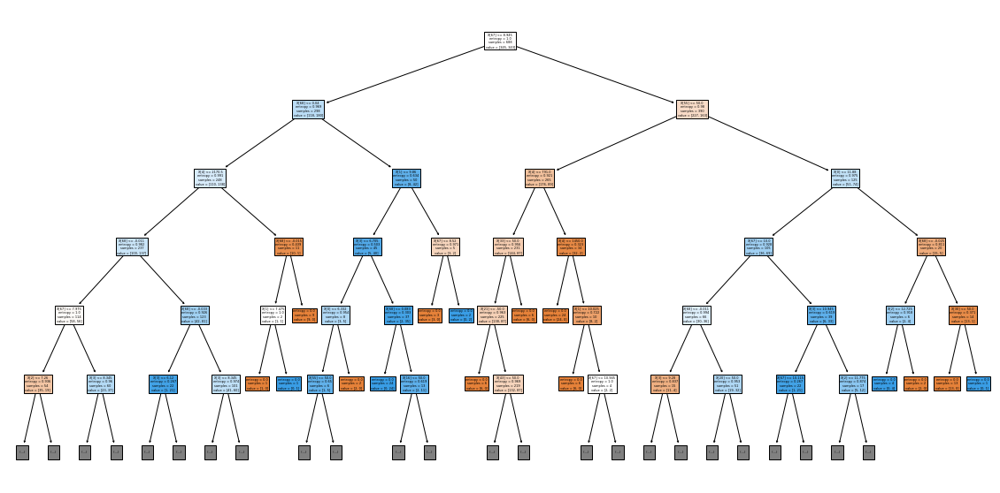

/home/brado/.local/lib/python3.8/site-packages/sklearn/utils/validation.py:68: FutureWarning:

Pass criterion=entropy as keyword args. From version 0.25 passing these as positional arguments will result in an error



~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.61      0.72      0.66       157
        True       0.71      0.60      0.65       182

    accuracy                           0.65       339
   macro avg       0.66      0.66      0.65       339
weighted avg       0.66      0.65      0.65       339

..............................vs................................
~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.41      0.47      0.44       165
        True       0.42      0.37      0.40       174

    accuracy                           0.42       339
   macro avg       0.42      0.42      0.42       339
weighted avg       0.42      0.42      0.42       339

~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~
                 ....../// [113  44] \\.........
                 .....///  [ 73 10

r2 score 0.9017931862681606
mean_absolute_er 1.246245592858475


440 440
440
440
STDR10:up_target:_1_HIT!


STDR10:up_target:_1_HIT!


STDR10:up_target:_1_HIT!


its here ill update it
cool i saved it!
target STDR10:up_target:_2_HIT! --> STDR10:down_target:_2_HIT!
target:      STDR10:up_target:_2_HIT! 
anti-target: STDR10:down_target:_2_HIT!


100%|██████████| 70/70 [00:00<00:00, 6235.16it/s]
/home/brado/.local/lib/python3.8/site-packages/sklearn/utils/validation.py:68: FutureWarning:

Pass criterion=entropy as keyword args. From version 0.25 passing these as positional arguments will result in an error



~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.70      0.75      0.73       224
        True       0.44      0.37      0.40       115

    accuracy                           0.63       339
   macro avg       0.57      0.56      0.57       339
weighted avg       0.61      0.63      0.62       339

..............................vs................................
~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.66      0.70      0.68       226
        True       0.31      0.27      0.28       113

    accuracy                           0.55       339
   macro avg       0.48      0.48      0.48       339
weighted avg       0.54      0.55      0.55       339

~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~
                 ....../// [169  55] \\.........
                 .....///  [72 43]

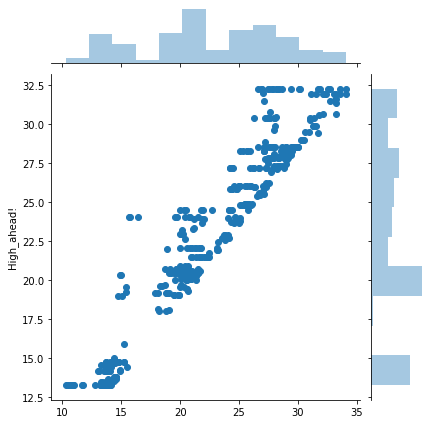

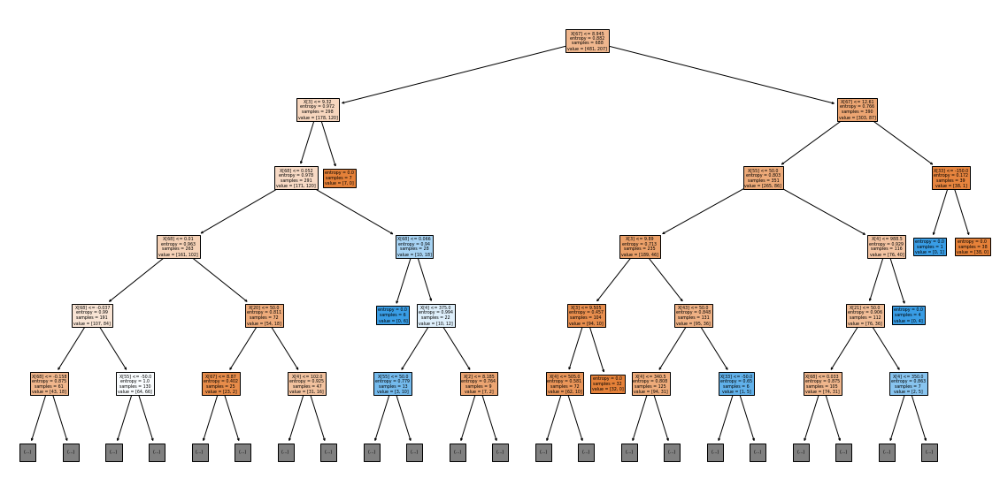

/home/brado/.local/lib/python3.8/site-packages/sklearn/utils/validation.py:68: FutureWarning:

Pass criterion=entropy as keyword args. From version 0.25 passing these as positional arguments will result in an error



~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.71      0.91      0.80       224
        True       0.60      0.28      0.38       115

    accuracy                           0.69       339
   macro avg       0.66      0.59      0.59       339
weighted avg       0.67      0.69      0.66       339

..............................vs................................
~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.64      0.81      0.72       226
        True       0.21      0.10      0.13       113

    accuracy                           0.58       339
   macro avg       0.43      0.46      0.43       339
weighted avg       0.50      0.58      0.52       339

~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~
                 ....../// [203  21] \\.........
                 .....///  [83 32]

r2 score 0.9017931862681606
mean_absolute_er 1.246245592858475


440 440
440
440
STDR10:up_target:_2_HIT!


STDR10:up_target:_2_HIT!


/home/brado/.local/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1221: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



STDR10:up_target:_2_HIT!


its here ill update it
cool i saved it!
target uped_10! --> downed_10!
target:      uped_10! 
anti-target: downed_10!


100%|██████████| 70/70 [00:00<00:00, 12378.84it/s]
/home/brado/.local/lib/python3.8/site-packages/sklearn/utils/validation.py:68: FutureWarning:

Pass criterion=entropy as keyword args. From version 0.25 passing these as positional arguments will result in an error



~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.80      0.85      0.83       247
        True       0.52      0.42      0.47        92

    accuracy                           0.74       339
   macro avg       0.66      0.64      0.65       339
weighted avg       0.72      0.74      0.73       339

..............................vs................................
~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.77      0.76      0.77       269
        True       0.13      0.14      0.14        70

    accuracy                           0.63       339
   macro avg       0.45      0.45      0.45       339
weighted avg       0.64      0.63      0.64       339

~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~
                 ....../// [211  36] \\.........
                 .....///  [53 39]

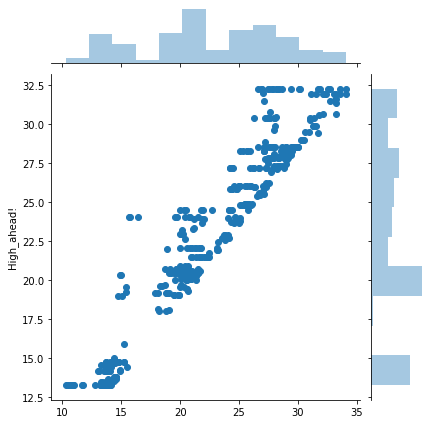

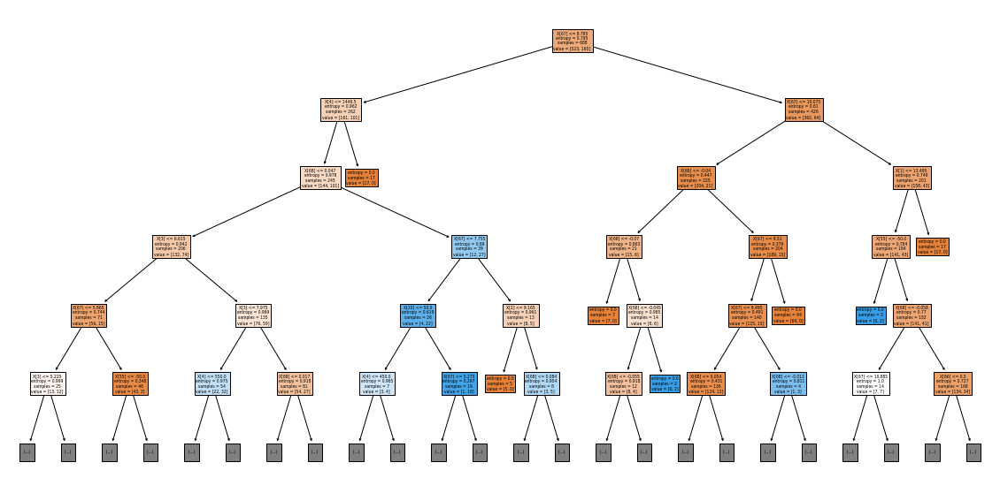

/home/brado/.local/lib/python3.8/site-packages/sklearn/utils/validation.py:68: FutureWarning:

Pass criterion=entropy as keyword args. From version 0.25 passing these as positional arguments will result in an error



~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.78      0.95      0.86       247
        True       0.67      0.28      0.40        92

    accuracy                           0.77       339
   macro avg       0.72      0.61      0.63       339
weighted avg       0.75      0.77      0.73       339

..............................vs................................
~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.80      0.89      0.84       269
        True       0.23      0.13      0.17        70

    accuracy                           0.73       339
   macro avg       0.51      0.51      0.50       339
weighted avg       0.68      0.73      0.70       339

~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~
                 ....../// [234  13] \\.........
                 .....///  [66 26]

r2 score 0.9017931862681606
mean_absolute_er 1.246245592858475


440 440
440
440
uped_10!


uped_10!


/home/brado/.local/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1221: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



uped_10!


its here ill update it
cool i saved it!
target downed_10! --> uped_10!
target:      downed_10! 
anti-target: uped_10!


100%|██████████| 70/70 [00:00<00:00, 10776.34it/s]
/home/brado/.local/lib/python3.8/site-packages/sklearn/utils/validation.py:68: FutureWarning:

Pass criterion=entropy as keyword args. From version 0.25 passing these as positional arguments will result in an error



~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.87      0.87      0.87       269
        True       0.50      0.49      0.49        70

    accuracy                           0.79       339
   macro avg       0.68      0.68      0.68       339
weighted avg       0.79      0.79      0.79       339

..............................vs................................
~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.70      0.77      0.74       247
        True       0.18      0.13      0.15        92

    accuracy                           0.60       339
   macro avg       0.44      0.45      0.44       339
weighted avg       0.56      0.60      0.58       339

~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~
                 ....../// [235  34] \\.........
                 .....///  [36 34]

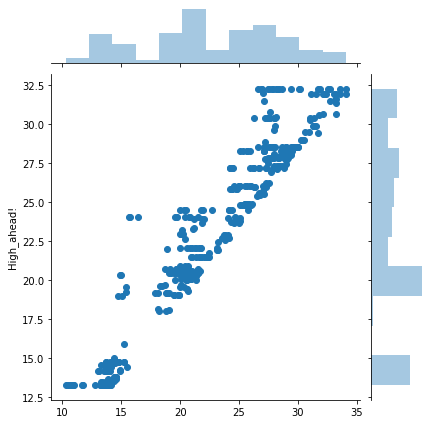

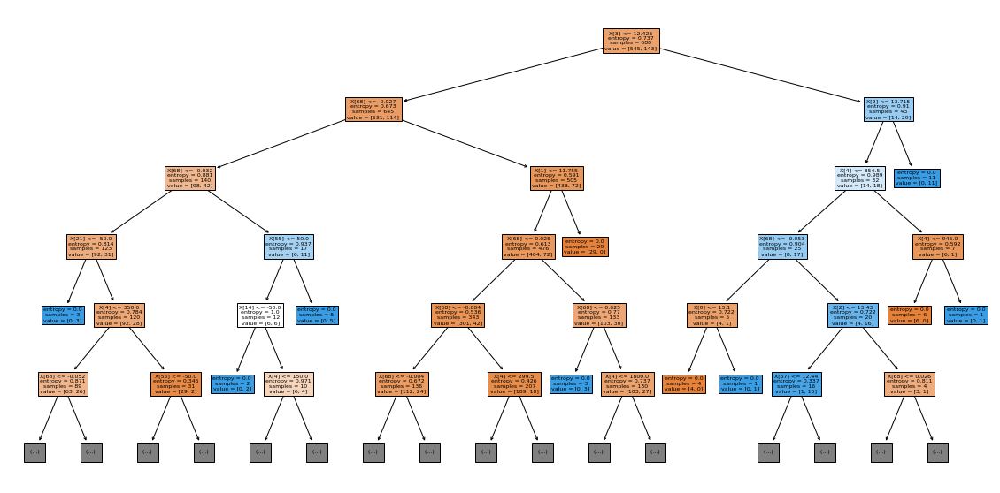

/home/brado/.local/lib/python3.8/site-packages/sklearn/utils/validation.py:68: FutureWarning:

Pass criterion=entropy as keyword args. From version 0.25 passing these as positional arguments will result in an error



~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.83      0.95      0.89       269
        True       0.59      0.27      0.37        70

    accuracy                           0.81       339
   macro avg       0.71      0.61      0.63       339
weighted avg       0.78      0.81      0.78       339

..............................vs................................
~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.71      0.89      0.79       247
        True       0.12      0.04      0.06        92

    accuracy                           0.66       339
   macro avg       0.42      0.47      0.43       339
weighted avg       0.55      0.66      0.59       339

~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~
                 ....../// [256  13] \\.........
                 .....///  [51 19]

r2 score 0.9017931862681606
mean_absolute_er 1.246245592858475


440 440
440
440
downed_10!


downed_10!


downed_10!


its here ill update it
cool i saved it!
target uped_20! --> downed_20!
target:      uped_20! 
anti-target: downed_20!


100%|██████████| 70/70 [00:00<00:00, 12292.80it/s]
/home/brado/.local/lib/python3.8/site-packages/sklearn/utils/validation.py:68: FutureWarning:

Pass criterion=entropy as keyword args. From version 0.25 passing these as positional arguments will result in an error



~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.94      0.94      0.94       308
        True       0.42      0.42      0.42        31

    accuracy                           0.89       339
   macro avg       0.68      0.68      0.68       339
weighted avg       0.89      0.89      0.89       339

..............................vs................................
~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.95      0.91      0.93       323
        True       0.03      0.06      0.04        16

    accuracy                           0.87       339
   macro avg       0.49      0.48      0.49       339
weighted avg       0.91      0.87      0.89       339

~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~
                 ....../// [290  18] \\.........
                 .....///  [18 13]

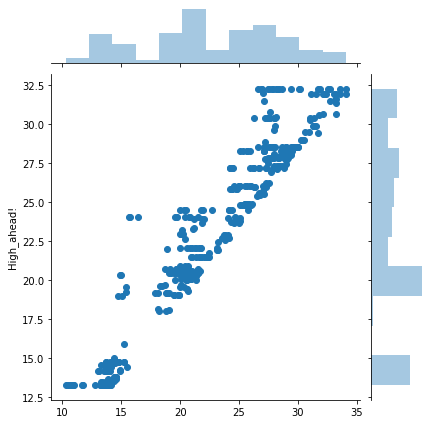

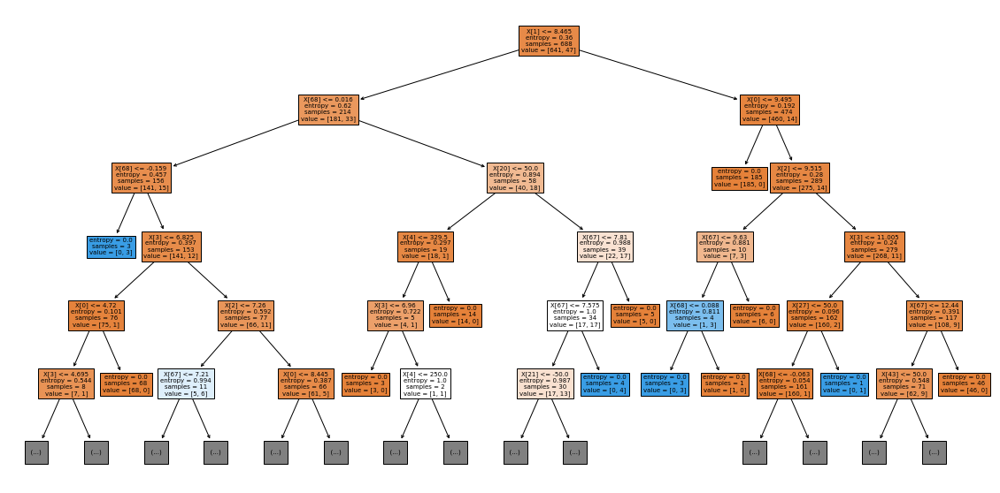

/home/brado/.local/lib/python3.8/site-packages/sklearn/utils/validation.py:68: FutureWarning:

Pass criterion=entropy as keyword args. From version 0.25 passing these as positional arguments will result in an error



~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.91      0.99      0.95       308
        True       0.40      0.06      0.11        31

    accuracy                           0.91       339
   macro avg       0.66      0.53      0.53       339
weighted avg       0.87      0.91      0.87       339

..............................vs................................
~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.95      0.98      0.97       323
        True       0.00      0.00      0.00        16

    accuracy                           0.94       339
   macro avg       0.48      0.49      0.48       339
weighted avg       0.91      0.94      0.92       339

~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~
                 ....../// [305   3] \\.........
                 .....///  [29  2]

r2 score 0.9017931862681606
mean_absolute_er 1.246245592858475


440 440
440
440
uped_20!


/home/brado/.local/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1221: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



uped_20!


/home/brado/.local/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1221: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



uped_20!


its here ill update it
cool i saved it!
target downed_20! --> uped_20!
target:      downed_20! 
anti-target: uped_20!


100%|██████████| 70/70 [00:00<00:00, 12437.04it/s]
/home/brado/.local/lib/python3.8/site-packages/sklearn/utils/validation.py:68: FutureWarning:

Pass criterion=entropy as keyword args. From version 0.25 passing these as positional arguments will result in an error



~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.97      0.96      0.96       323
        True       0.28      0.31      0.29        16

    accuracy                           0.93       339
   macro avg       0.62      0.64      0.63       339
weighted avg       0.93      0.93      0.93       339

..............................vs................................
~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.90      0.94      0.92       308
        True       0.00      0.00      0.00        31

    accuracy                           0.86       339
   macro avg       0.45      0.47      0.46       339
weighted avg       0.82      0.86      0.84       339

~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~
                 ....../// [310  13] \\.........
                 .....///  [11  5]

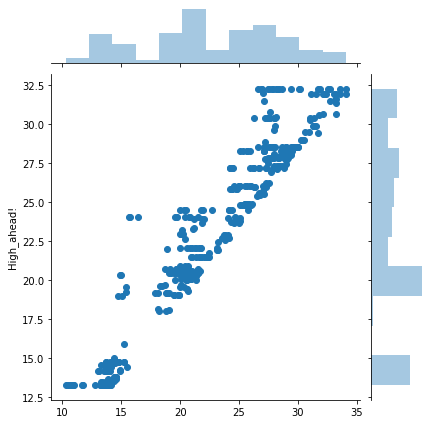

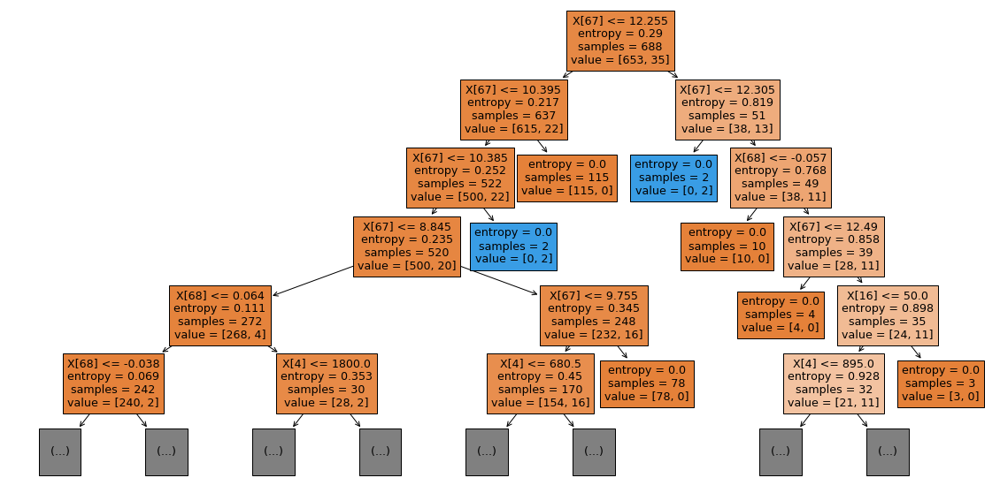

/home/brado/.local/lib/python3.8/site-packages/sklearn/utils/validation.py:68: FutureWarning:

Pass criterion=entropy as keyword args. From version 0.25 passing these as positional arguments will result in an error



~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.96      0.99      0.97       323
        True       0.33      0.06      0.11        16

    accuracy                           0.95       339
   macro avg       0.64      0.53      0.54       339
weighted avg       0.93      0.95      0.93       339

..............................vs................................
~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.91      0.99      0.95       308
        True       0.00      0.00      0.00        31

    accuracy                           0.90       339
   macro avg       0.45      0.50      0.47       339
weighted avg       0.82      0.90      0.86       339

~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~
                 ....../// [321   2] \\.........
                 .....///  [15  1]

r2 score 0.9017931862681606
mean_absolute_er 1.246245592858475


440 440
440
440
downed_20!


downed_20!


downed_20!


its here ill update it
cool i saved it!
target uped_5! --> downed_5!
target:      uped_5! 
anti-target: downed_5!


100%|██████████| 70/70 [00:00<00:00, 14217.98it/s]
/home/brado/.local/lib/python3.8/site-packages/sklearn/utils/validation.py:68: FutureWarning:

Pass criterion=entropy as keyword args. From version 0.25 passing these as positional arguments will result in an error



~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.66      0.80      0.72       186
        True       0.67      0.51      0.58       153

    accuracy                           0.67       339
   macro avg       0.67      0.65      0.65       339
weighted avg       0.67      0.67      0.66       339

..............................vs................................
~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.55      0.62      0.58       197
        True       0.35      0.29      0.32       142

    accuracy                           0.48       339
   macro avg       0.45      0.45      0.45       339
weighted avg       0.47      0.48      0.47       339

~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~
                 ....../// [148  38] \\.........
                 .....///  [75 78]

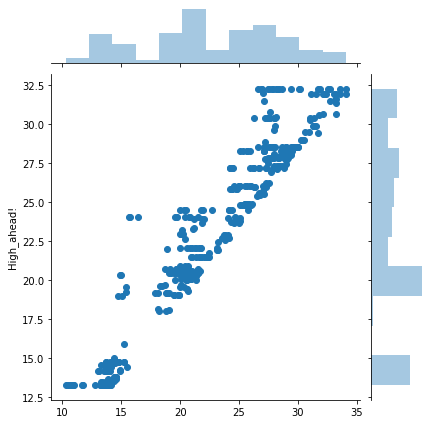

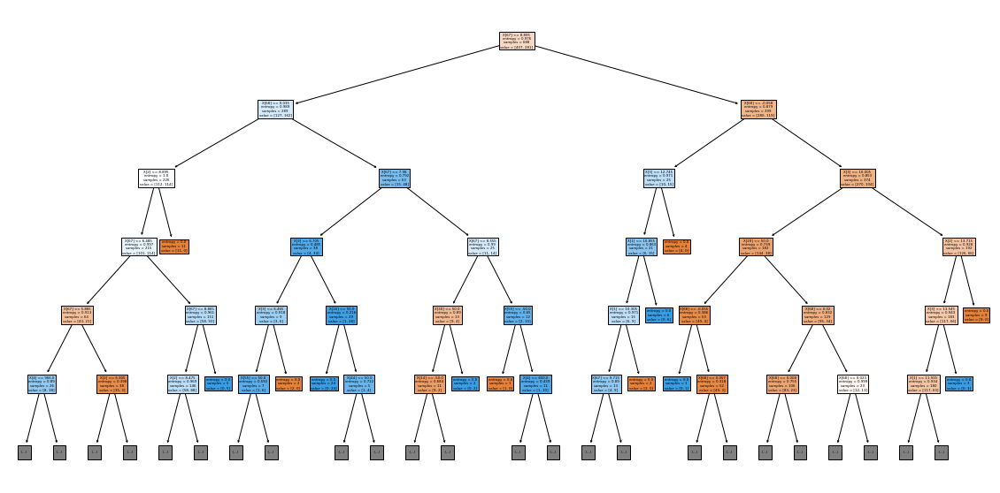

/home/brado/.local/lib/python3.8/site-packages/sklearn/utils/validation.py:68: FutureWarning:

Pass criterion=entropy as keyword args. From version 0.25 passing these as positional arguments will result in an error



~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.68      0.83      0.75       186
        True       0.72      0.53      0.61       153

    accuracy                           0.69       339
   macro avg       0.70      0.68      0.68       339
weighted avg       0.70      0.69      0.69       339

..............................vs................................
~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.53      0.61      0.57       197
        True       0.32      0.25      0.28       142

    accuracy                           0.46       339
   macro avg       0.42      0.43      0.42       339
weighted avg       0.44      0.46      0.45       339

~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~
                 ....../// [154  32] \\.........
                 .....///  [72 81]

r2 score 0.9017931862681606
mean_absolute_er 1.246245592858475


440 440
440
440
uped_5!


uped_5!


uped_5!


its here ill update it
cool i saved it!
target downed_5! --> uped_5!
target:      downed_5! 
anti-target: uped_5!


100%|██████████| 70/70 [00:00<00:00, 9711.93it/s]
/home/brado/.local/lib/python3.8/site-packages/sklearn/utils/validation.py:68: FutureWarning:

Pass criterion=entropy as keyword args. From version 0.25 passing these as positional arguments will result in an error



~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.67      0.70      0.68       197
        True       0.56      0.54      0.55       142

    accuracy                           0.63       339
   macro avg       0.62      0.62      0.62       339
weighted avg       0.63      0.63      0.63       339

..............................vs................................
~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.50      0.55      0.52       186
        True       0.38      0.34      0.36       153

    accuracy                           0.45       339
   macro avg       0.44      0.44      0.44       339
weighted avg       0.45      0.45      0.45       339

~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~
                 ....../// [137  60] \\.........
                 .....///  [66 76]

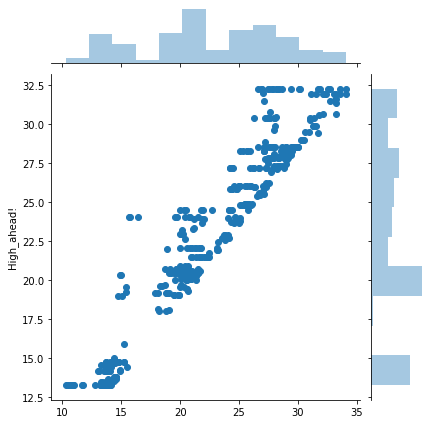

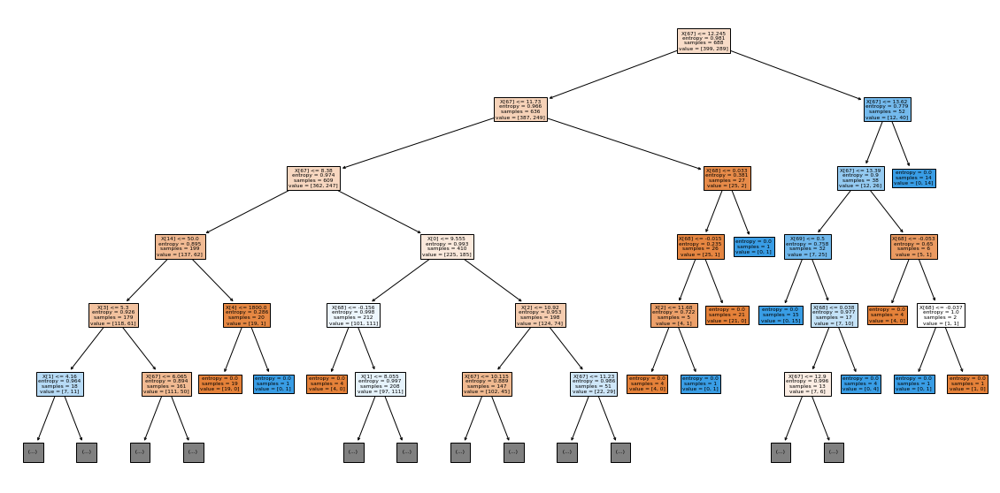

/home/brado/.local/lib/python3.8/site-packages/sklearn/utils/validation.py:68: FutureWarning:

Pass criterion=entropy as keyword args. From version 0.25 passing these as positional arguments will result in an error



~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.66      0.69      0.67       197
        True       0.54      0.51      0.52       142

    accuracy                           0.61       339
   macro avg       0.60      0.60      0.60       339
weighted avg       0.61      0.61      0.61       339

..............................vs................................
~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~
               precision    recall  f1-score   support

       False       0.48      0.53      0.50       186
        True       0.34      0.29      0.31       153

    accuracy                           0.42       339
   macro avg       0.41      0.41      0.41       339
weighted avg       0.41      0.42      0.42       339

~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~
                 ....../// [136  61] \\.........
                 .....///  [70 72]

r2 score 0.9017931862681606
mean_absolute_er 1.246245592858475


440 440
440
440
downed_5!


downed_5!


downed_5!


its here ill update it
cool i saved it!


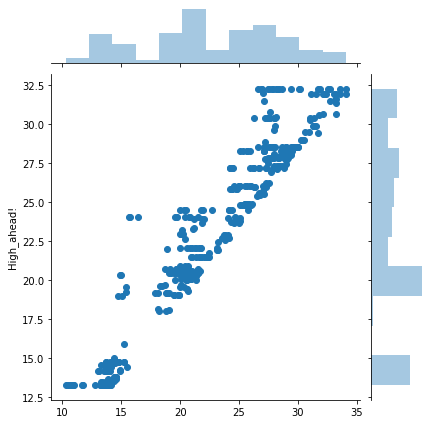

In [26]:

for ml_target in tarli:
    try:
        target  = targs[ml_target]

        if 'up' in target:
            dtarget = target.replace('up','down')
        elif 'down' in target:
            dtarget = target.replace('down','up')

        elif 'above' in target:
            dtarget = target.replace('above','below')
        elif 'below' in target:
            dtarget = target.replace('below','above')
        print('target',target, '-->',dtarget)


        #dtarget = targs[13]

        print('target:     ',target, '\nanti-target:',dtarget)

        info['target'] = df[target]

        ## <<<<<<<<<<<<<<<<< `LOGISTIC MODEL` >>>>>>>>>>>>>>>>>>>>
        from sklearn.linear_model import LogisticRegression
        from sklearn.metrics import classification_report, confusion_matrix,r2_score

        ### -------------------------------({bionary} target selection)----------------------------------

        #sns.heatmap(df.isnull())

        # ==============this is where i need to add d target to one log_reg_fit!


        x = fe_first
        x = x.drop(['date'],axis=1)
        #x = scale(x)
        y = df_first[target]
        dy = df_first[dtarget]



        x_train,x_test,y_train,y_test = ttsplit(x,y)
        dx_train,dx_test,dy_train,dy_test = ttsplit(x,dy)



        x

        def log_reg_fit(x,y,dy,name=' ',notes=''):
            #ouputs the model, model_id, predictions & coef_df in a list, while saving all parmas to 'modeldic'
            #runs a Logistic model and save the paramaters, outputs,
            #the model,model_id, prediction, and a coeficiant dataframe 

            indic = {}
            mstamp = str(datetime.now())
            '''model'''
            mtype = 'LogisticRegression'
            sn = mstamp.split('.')[1]
            modelid = mtype+sn
            #adding paramaters
            indic['model_id'] = modelid
            indic['model_name'] = target+modelid #this is striclty beinf used for nameing
            indic['model_notes'] = 'max_iter is on 4000'#notes
            indic['stamp'] = mstamp
            indic['model_type'] = mtype
            indic['features'] = str(x.columns)
            indic['target']   = target
            #setting up model
            '''object name'''
            lr = LogisticRegression(max_iter=4000)
            lr.fit(x_train,y_train)
            pred = lr.predict(x_test)
            #dont think this will work on 
            coef = lr.coef_ 

            codf = pd.DataFrame(coef,columns=[x.columns])#,x.columns)#,columns=['coefs'])
            #this would be if you wanted to rank them ....
            #for i in trange(0,len(codf)):
            #    if codf['coefs'][i] < 0:
            #        codf['coefs'][i] = codf['coefs'][i] * -1
            #codf = codf.T

            codf.iplot(kind='bar',theme='solar')

            #metrics
            clr = classification_report(y_test,pred)
            dclr= classification_report(dy_test,pred)
            '''
            print('~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~\n',clr)
            print('..............................vs................................')
            print('~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~\n',dclr)
            comx = confusion_matrix(y_test,pred)
            print("~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~" )
            print("                 ......///",comx[0], "\\\........." )
            print("                 ...../// ",comx[1], " \\\........." )
            '''
            #classification report
            clr = classification_report(y_test,pred,output_dict=True)
            clrdf = pd.DataFrame(clr)
            indic['true_positive']=clr['True']['precision']
            indic['true_negitive']=clr['False']['precision']
            indic['weighted avg'] =clr['weighted avg']['precision']
            indic['f1_score']     =clr['weighted avg']['f1-score']
            codf
            modeldic[modelid] = indic
            return [lr, modelid, pred,clrdf,codf] #,codf.T.iplot(kind='bar',theme='solar')


        lr = log_reg_fit(x_train,y_train,dy_train)


        lr[4].T.reset_index().sort_values(0,ascending=False)



        os.listdir()

        def save_log_coefs():
            name = lr[1]
            coefs = lr[4]
            codf = coefs.T
            codf = codf.reset_index().rename(columns={'level_0':'features',0:'coef'})
            codf['true_coef'] = codf['coef']
            for i in trange(0,len(codf)):
                if codf['coef'][i] < 0:
                    codf['coef'][i] = codf['coef'][i] * -1
            p = 'PREDICTION_DATA/'
            if not os.path.exists(p):
                os.mkdir(p)
            csname = ('coefs_'+target+'_split:'+str(split)+'.csv')
            codf.to_csv(p+csname)
            return codf.sort_values('coef',ascending=False)
        save_log_coefs()



        # Saving the Coefs Sheet







        # SWEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEEET
        ## .............................................TODO

        ### OK THIS IS THE TEMPLATE TO APPLY TO THE REST OF THE BIONARY MODELS





        lr[3]

        ## <<<<<<<<<<<<<<<<<<<<<<< `TREE` >>>>>>>>>>>>>>>>>>>>>>>>>>

        from sklearn.tree import DecisionTreeClassifier

        tree = tree_fit(x,y,dy_train)

        tree

        tree[3]

        from sklearn.tree import plot_tree

        plt.figure(figsize=(20,10))
        plot_tree(tree[0],filled=True,max_depth=5)
        plt.show()

        lr[4].T.reset_index()

        ## <<<<<<<<<<<<<<<<<<<< `FOREST` >>>>>>>>>>>>>>>>>>>>>>>

        from sklearn.ensemble import RandomForestClassifier



        forest = forest_fit(x,y_train,dy_train)

        forest[3]

        modf = pd.DataFrame(modeldic)
        modf

        #     [[[[[[[[{{{{{{{{{{{ ~VALIDATE~ ! }}}}}}}}}}]]]]]]]]]]]

        os.listdir(path)

        ddf['Date'] = ddf['date']
        #predf = second.copy()
        df.head()

        ### LIN TARGET

        x = fe_second[lx.columns]
        y = df_second[ltarget]


        sola(x)

        ## <<<<<<<<<<<<<<<<<<<< `LINEAR` >>>>>>>>>>>>>>>>>>>>>>>

        predf = df_second[['Close',target]] 
        lmp = lin_validate(lm,x)



        ## <<<<<<<<<<<<<<<<<<<< `LOGISTIC` >>>>>>>>>>>>>>>>>>>>>>>

        ### BIONARY TARGET

        ### TODO
        #### #add the date to result data frame
        #### #add a plot of price to scale on the real close price
        #### >add classification report with oposite values
        #### # save metrics to dict...
        ####  #true metrics vs pred plot,(just bionarys )
        #### > add title & save image params to sola function  
        #### > add a prediction only function


        def binary_validate(mdl,x,dy):
            pred = mdl[0].predict(x)
            predf[mdl[1]] = pred
            redf = predf[[target,'Close',mdl[1]]]
            redf['time'] = ddf['Date']
            redf.set_index('time',inplace=True)
            sdf = scale(redf)
            sdf['time'] = ddf['Date']
            sdf.set_index('time',inplace=True)
            #metrics
            clr = classification_report(y,pred)
            dclr= classification_report(dy,pred)
            '''
            print('~~~~~~~~~~~~~~~~~~~~~~~HITTNG THE TARGET~~~~~~~~~~~~~~~~~~~~~~~~~\n',clr)
            print('..............................vs................................')
            print('~~~~~~~~~~~~~~~~~~~~~~~ THE ANTI-TARGET~~~~~~~~~~~~~~~~~~~~~~~~~\n',dclr)
            comx = confusion_matrix(y,pred)
            print("~~~~~~~~~~~~~~~~~~~~~~[CONFUSION MATRIX:]~~~~~~~~~~~~~~~~~~~~~~~" )
            print("                 ......///",comx[0], "\\\........." )
            print("                 ...../// ",comx[1], " \\\........." )
            '''
            #the real price plot
            scale2close= mdl[1]+'_$scale'
            redf[scale2close] = redf[mdl[1]].replace(True,1)
            redf[scale2close] = redf[scale2close].replace(1,redf['Close'])
            print(sdf[target].name)
            sola(redf[['Close',scale2close]])
            #scaled close
            #sola(sdf.drop(target,1))
            #scaled bionary
            #sola(sdf[[target,mdl[1]]])
            clr = classification_report(y,pred,output_dict=True)
            clrdf = pd.DataFrame(clr)
            dclr = classification_report(dy,pred,output_dict=True)
            dclrdf = pd.DataFrame(dclr)
            modeldic[mdl[1]]['target']      = target
            modeldic[mdl[1]]['true_positive']=clr['True']['precision']
            modeldic[mdl[1]]['true_negitive']=clr['False']['precision']
            modeldic[mdl[1]]['weighted avg'] =clr['weighted avg']['precision']
            modeldic[mdl[1]]['f1_score']     =clr['weighted avg']['f1-score']
            modeldic[mdl[1]]['dtrue_positive']=dclr['True']['precision']
            modeldic[mdl[1]]['dtrue_negitive']=dclr['False']['precision']
            modeldic[mdl[1]]['dweighted avg'] =dclr['weighted avg']['precision']
            modeldic[mdl[1]]['df1_score']     =dclr['weighted avg']['f1-score']
            modeldic[mdl[1]]['true_dtrue_dif']=clr['True']['precision'] - dclr['True']['precision']
            modeldic[mdl[1]]['wt_dwt_avg_dif'] =clr['weighted avg']['precision']-dclr['weighted avg']['precision']
            modeldic[mdl[1]]['f1_score']
            #modeldic[mdl[1]] = dic
            return redf,pred



        print(len(fe_second),len(df_second))

        print(len(df_second[target]))
        print(len(fe_second))

        x = fe_second
        x = x.drop(['date'],axis=1)
        y = df_second[target]#.replace(1,True).replace(0,False)
        dy = df_second[dtarget]#.replace(1,True).replace(0,False)
        x.head()



        lrp = binary_validate(lr,x,dy)


        # Predf is a dataframe ofall the predictions?

        predf



        ## <<<<<<<<<<<<<<<<<<<< `TREE` >>>>>>>>>>>>>>>>>>>>>>>

        treep = binary_validate(tree,x,dy)

        redf = treep[0]
        redf[dtarget] = df[dtarget]








        ## <<<<<<<<<<<<<<<<<<<< `FOREST` >>>>>>>>>>>>>>>>>>>>>>>

        forestp = binary_validate(forest,x,dy) 

        forestp[0]

        pd.DataFrame(modeldic)



        modf = pd.DataFrame(modeldic)

        ## try adding more bars here

        



        # [[[[[[[[{{{{{{{{{{{ SAVE RESULTS ZONE! }}}}}}}}}}]]]]]]]]]]]

        
         ### save predictions

        predf['date'] = df['date']

        pppath = 'PREDICTION_DATA/predictions/'
        if not os.path.exists(pppath):
            os.mkdir(pppath)
        pppname = (pppath+target+'_split:'+str(split)+'.csv')
        predf.to_csv(pppname)


        fin = 'fin:'+str(datetime.now()) 

        
        
        fin = 'fin:'+str(datetime.now()) 

        import pickle

        

        def pickle_suprise(model):
            # save the model to disk
            modell = model[0]
            pickle_path = ('pickles/')
            if not os.path.exists(pickle_path):
                os.mkdir(pickle_path)
            filename = (pickle_path+model[1])
            pickle.dump(modell, open(filename, 'wb'))

            # some time later...

            # load the model from disk
            #loaded_model = pickle.load(open(filename, 'rb'))
            #result = loaded_model.score(x_test, y_test)
            #print(result)
            #print(filename)

        save_info()
        #eventually these should go into the save_info function, but this works nive ads a hard stop
        pickle_suprise(lm)
        pickle_suprise(lr)
        pickle_suprise(tree)
        pickle_suprise(forest)
    
    except IndexError:
        pass
    #except KeyError:
    #    pass
    #except ValueError:
    #    pass
    

# Common Errors

In [27]:
#except IndexError:
    #   pass
    #except KeyError:
    #    pass
    #except ValueError:
    #    pass
    

In [28]:
modf.T[['true_dtrue_dif','wt_dwt_avg_dif']].iplot(kind='bar',theme='solar')

modeldic[lm[1]].keys()

dict_keys(['model_id', 'model_name', 'model_notes', 'stamp', 'model_type', 'features', 'target', 'r2_score', 'MAE', 'coefs'])

In [29]:
clean_compleate = datetime.now()
notebook_runtime = clean_compleate - clean_initiate
print('notebook ran in: ',notebook_runtime)


notebook ran in:  0:02:00.659483


In [30]:
mpdf = pd.read_csv('PREDICTION_DATA/model_preformance.csv',index_col='index')
mpdf.T[['true_dtrue_dif','wt_dwt_avg_dif']].iplot(theme='solar',fill=True)
mpdf.T[['true_dtrue_dif','wt_dwt_avg_dif']].iplot(theme='solar',kind='bar')
mpdf.T[['true_positive','weighted avg','true_negitive','f1_score']].iplot(theme='solar',kind='bar')

# you have to add notes or it wont save csv_name
### odly enough true_negitive is more important than true negitive...makes sence

In [31]:
mpdf

,LinearRegression099256,LogisticRegression692566,Tree997631,forest775524,LogisticRegression076862,Tree531440,forest233167,LogisticRegression673553,Tree645715,forest874537,LogisticRegression982984,Tree811980,forest412941,LogisticRegression247293,Tree234818,forest746586,LogisticRegression482199,Tree226961,forest732965,LogisticRegression437004,Tree823386,forest103252,LogisticRegression955226,Tree254989,forest881887,LogisticRegression590657,Tree772907,forest332842,LogisticRegression422093,Tree414259,forest422992,LogisticRegression716808,Tree340511,forest489838,LogisticRegression984062,Tree979859,forest984381
index,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
model_id,LinearRegression099256,LogisticRegression692566,Tree997631,forest775524,LogisticRegression076862,Tree531440,forest233167,LogisticRegression673553,Tree645715,forest874537,LogisticRegression982984,Tree811980,forest412941,LogisticRegression247293,Tree234818,forest746586,LogisticRegression482199,Tree226961,forest732965,LogisticRegression437004,Tree823386,forest103252,LogisticRegression955226,Tree254989,forest881887,LogisticRegression590657,Tree772907,forest332842,LogisticRegression422093,Tree414259,forest422992,LogisticRegression716808,Tree340511,forest489838,LogisticRegression984062,Tree979859,forest984381
model_name,High_ahead!LinearRegression099256,STDR10:down_target:_2_HIT!LogisticRegression69...,STDR10:down_target:_2_HIT!Tree997631,STDR10:down_target:_2_HIT!forest775524,STDR10:down_target:_1_HIT!LogisticRegression07...,STDR10:down_target:_1_HIT!Tree531440,STDR10:down_target:_1_HIT!forest233167,STDR10:down_target:_0.5_HIT!LogisticRegression...,STDR10:down_target:_0.5_HIT!Tree645715,STDR10:down_target:_0.5_HIT!forest874537,STDR10:up_target:_0.5_HIT!LogisticRegression98...,STDR10:up_target:_0.5_HIT!Tree811980,STDR10:up_target:_0.5_HIT!forest412941,STDR10:up_target:_1_HIT!LogisticRegression247293,STDR10:up_target:_1_HIT!Tree234818,STDR10:up_target:_1_HIT!forest746586,STDR10:up_target:_2_HIT!LogisticRegression482199,STDR10:up_target:_2_HIT!Tree226961,STDR10:up_target:_2_HIT!forest732965,uped_10!LogisticRegression437004,uped_10!Tree823386,uped_10!forest103252,downed_10!LogisticRegression955226,downed_10!Tree254989,downed_10!forest881887,uped_20!LogisticRegression590657,uped_20!Tree772907,uped_20!forest332842,downed_20!LogisticRegression422093,downed_20!Tree414259,downed_20!forest422992,uped_5!LogisticRegression716808,uped_5!Tree340511,uped_5!forest489838,downed_5!LogisticRegression984062,downed_5!Tree979859,downed_5!forest984381
model_notes,fit_intercept=False,max_iter is on 4000,default-tree,running 200 estimators,max_iter is on 4000,default-tree,running 200 estimators,max_iter is on 4000,default-tree,running 200 estimators,max_iter is on 4000,default-tree,running 200 estimators,max_iter is on 4000,default-tree,running 200 estimators,max_iter is on 4000,default-tree,running 200 estimators,max_iter is on 4000,default-tree,running 200 estimators,max_iter is on 4000,default-tree,running 200 estimators,max_iter is on 4000,default-tree,running 200 estimators,max_iter is on 4000,default-tree,running 200 estimators,max_iter is on 4000,default-tree,running 200 estimators,max_iter is on 4000,default-tree,running 200 estimators
stamp,2020-11-03 18:37:42.504733,2020-11-03 18:37:42.504733,2020-11-03 18:37:42.504733,2020-11-03 18:37:42.504733,2020-11-03 18:37:42.504733,2020-11-03 18:37:42.504733,2020-11-03 18:37:42.504733,2020-11-03 18:37:42.504733,2020-11-03 18:37:42.504733,2020-11-03 18:37:42.504733,2020-11-03 18:37:42.504733,2020-11-03 18:37:42.504733,2020-11-03 18:37:42.504733,2020-11-03 18:37:42.504733,2020-11-03 18:37:42.504733,2020-11-03 18:37:42.504733,2020-11-03 18:37:42.504733,2020-11-03 18:37:42.504733,2020-11-03 18:37:42.504733,2020-11-03 18:37:42.504733,2020-11-03 18:37:42.504733,2020-11-03 18:37:42.504733,2020-11-03 18:37:42.504733,2020-11-03 18:37:42.504733,2020-11-03 18:37:42.504733,2020-11-03 18:37:42.504733,2020-11-03 18:37:42.504733,2020-11-03 18:37:42.504733,2020-11-03 18:

In [32]:
#!>models.md
stamp

'2020-11-03 18:37:42.504733'

In [33]:

print('notebook runtime:\n'
      ,str(datetime.now() -pd.to_datetime(stamp)).split(' ')[2].split('.')[0])

notebook runtime:
 00:02:00
